## OCR (PaddleOCR)

OCRを使って、画像に文字が記載されている場所をBoxで囲む

- quick start: https://paddlepaddle.github.io/PaddleOCR/latest/en/ppocr/quick_start.html
- draw_ocr: https://github.com/PaddlePaddle/PaddleOCR/blob/main/tools/infer/utility.py#L451

In [3]:
import os

from PIL import Image
from paddleocr import PaddleOCR, draw_ocr

In [2]:
!ls ../menu_images

menu1.jpg menu2.jpg menu3.jpg menu4.jpg


In [24]:
# original image
image_for_ocr = [os.path.join('../menu_images', jpg) for jpg in ['menu1.jpg','menu2.jpg','menu3.jpg','menu4.jpg']]
# save image name for the image with ocr res
save_images = [os.path.join('results', jpg) for jpg in ['menu1/menu1_ocr.jpg','menu2/menu2_ocr.jpg','menu3/menu3_ocr.jpg','menu4/menu4_ocr.jpg']]
image_for_ocr, save_images

(['../menu_images/menu1.jpg',
  '../menu_images/menu2.jpg',
  '../menu_images/menu3.jpg',
  '../menu_images/menu4.jpg'],
 ['results/menu1/menu1_ocr.jpg',
  'results/menu2/menu2_ocr.jpg',
  'results/menu3/menu3_ocr.jpg',
  'results/menu4/menu4_ocr.jpg'])

In [7]:
ocr = PaddleOCR(use_angle_cls=False, lang='japan')
type(ocr)

[2025/01/22 14:38:28] ppocr DEBUG: Namespace(alpha=1.0, alphacolor=(255, 255, 255), benchmark=False, beta=1.0, binarize=False, cls_batch_num=6, cls_image_shape='3, 48, 192', cls_model_dir='/Users/YShimada-MBP16/.paddleocr/whl/cls/ch_ppocr_mobile_v2.0_cls_infer', cls_thresh=0.9, cpu_threads=10, crop_res_save_dir='./output', det=True, det_algorithm='DB', det_box_type='quad', det_db_box_thresh=0.6, det_db_score_mode='fast', det_db_thresh=0.3, det_db_unclip_ratio=1.5, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_east_score_thresh=0.8, det_limit_side_len=960, det_limit_type='max', det_model_dir='/Users/YShimada-MBP16/.paddleocr/whl/det/ml/Multilingual_PP-OCRv3_det_infer', det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, det_pse_thresh=0, det_sast_nms_thresh=0.2, det_sast_score_thresh=0.5, draw_img_save_dir='./inference_results', drop_score=0.5, e2e_algorithm='PGNet', e2e_char_dict_path='./ppocr/utils/ic15_dict.txt', e2e_limit_side_len=768, e2e_limit_type='max', e2e_

paddleocr.paddleocr.PaddleOCR

In [11]:
%%time

res_images = []
for img in image_for_ocr:
    print('>>> ', img)
    
    # OCR
    result = ocr.ocr(img, cls=True)
    print(len(result[0]))

    # Draw Image
    result_draw = result[0]
    image = Image.open(img).convert('RGB')
    boxes = [line[0] for line in result_draw]
    txts = [line[1][0] for line in result_draw]
    scores = [line[1][1] for line in result_draw]
    #im_show = draw_ocr(image, boxes, txts, scores, font_path='./fonts/simfang.ttf')
    im_show = draw_ocr(image, boxes, drop_score=0.1, font_path='./fonts/simfang.ttf')
    im_show = Image.fromarray(im_show)

    res_images.append(im_show)
    im_show

>>>  ../menu_images/menu1.jpg
[2025/01/22 14:43:26] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
[2025/01/22 14:43:26] ppocr DEBUG: dt_boxes num : 73, elapsed : 0.40619683265686035
[2025/01/22 14:43:35] ppocr DEBUG: rec_res num  : 73, elapsed : 8.394383907318115
69
>>>  ../menu_images/menu2.jpg
[2025/01/22 14:43:35] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
[2025/01/22 14:43:36] ppocr DEBUG: dt_boxes num : 211, elapsed : 0.6440918445587158
[2025/01/22 14:43:58] ppocr DEBUG: rec_res num  : 211, elapsed : 22.087472915649414
194
>>>  ../menu_images/menu3.jpg
[2025/01/22 14:43:59] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
[2025/01/22 14:44:00] ppocr DEBUG: dt_boxes num : 137, elapsed : 0.4928319454193115
[2025/01/22 14:44:13] ppocr DEBUG: rec_res num  : 137, elapsed : 13.712998867034912
124
>>> 

In [19]:
res_images

[<PIL.Image.Image image mode=RGB size=595x842>,
 <PIL.Image.Image image mode=RGB size=3508x2480>,
 <PIL.Image.Image image mode=RGB size=2339x1654>,
 <PIL.Image.Image image mode=RGB size=2970x2100>]

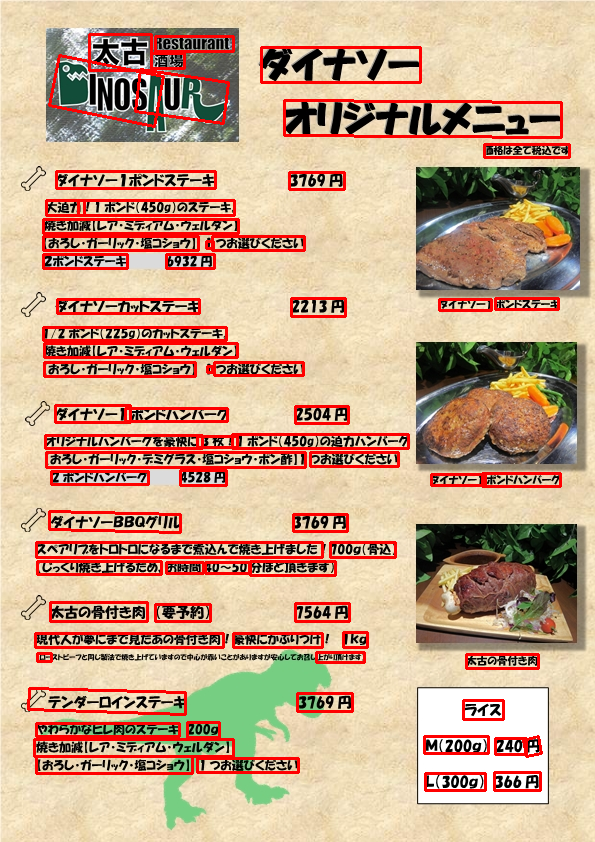

In [15]:
res_images[0]

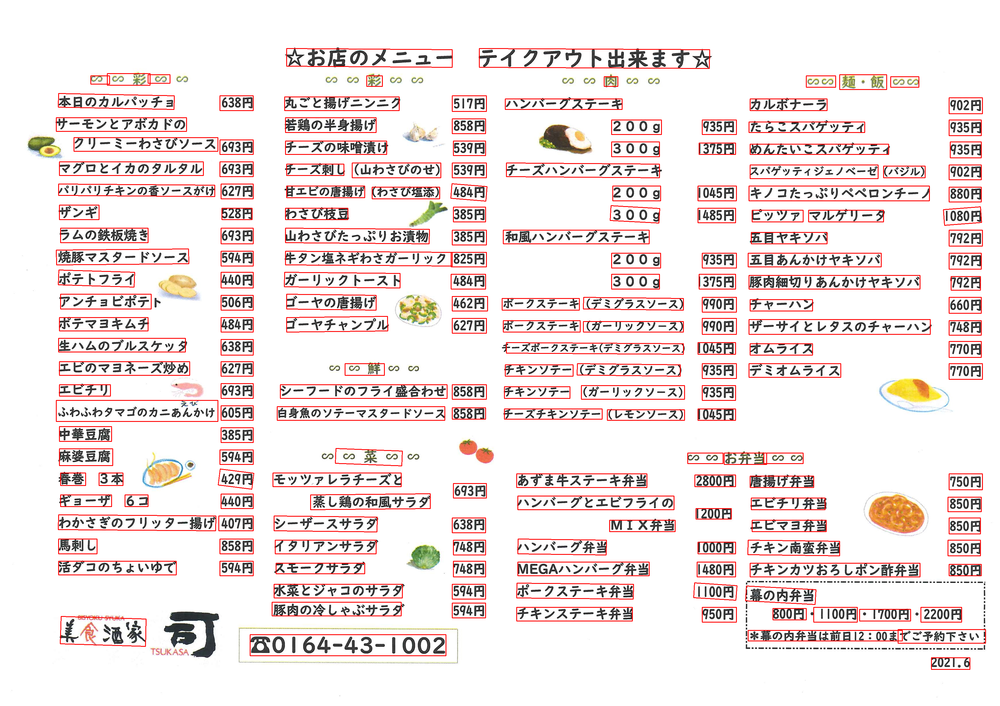

In [16]:
res_images[1]

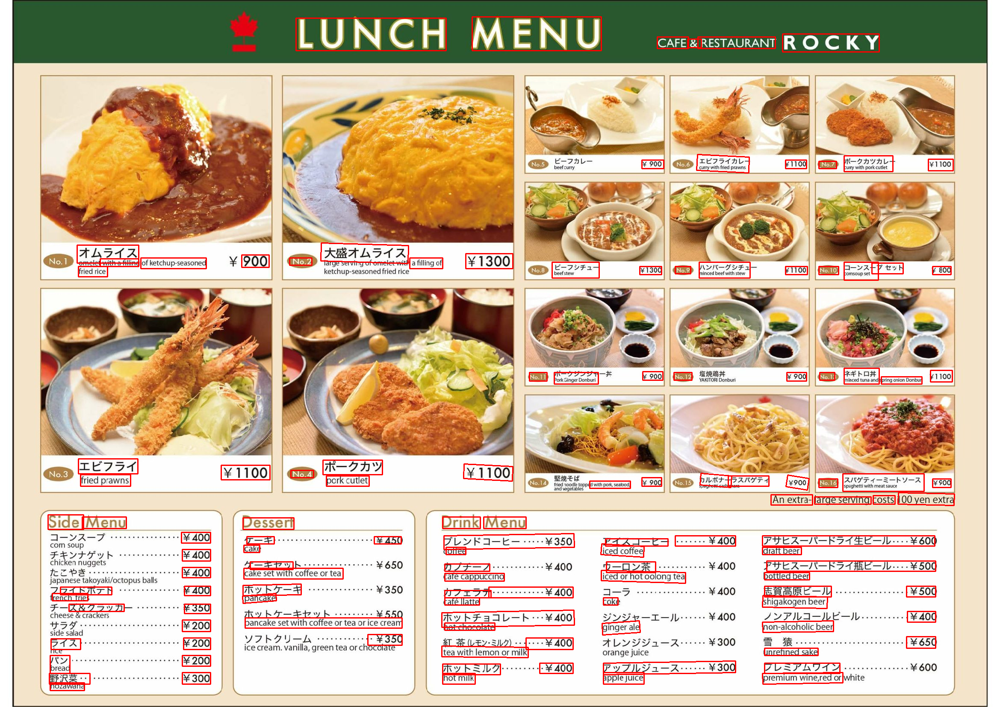

In [17]:
res_images[2]

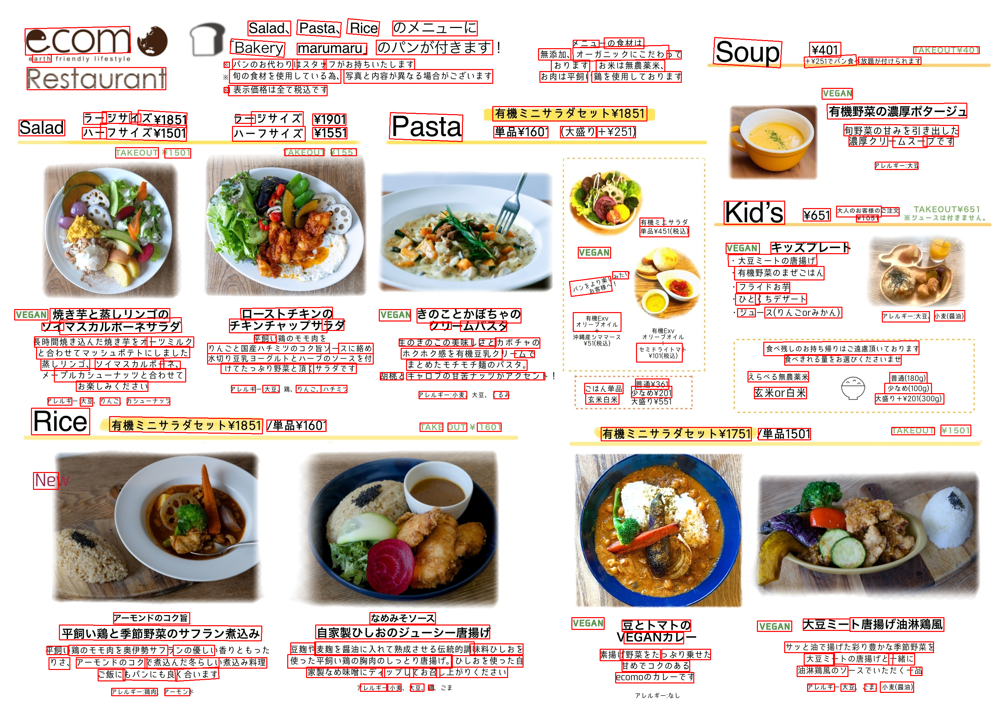

In [18]:
res_images[3]

In [25]:
# save images
for i,save in enumerate(save_images):
    res_images[i].save(save)

In [28]:
!ls results/menu1

menu1_ocr.jpg   replyOAI_VM.csv
